In [1]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

from datetime import timedelta, datetime
#import holidays

import matplotlib
import pickle
import seaborn as sns

import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objs as go

matplotlib.pyplot.style.use('ggplot')
%matplotlib inline

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.float_format', lambda x: '%.6f' % x)
pd.set_option('display.width', 500)

In [2]:
df_poor = pd.read_csv('../../../data/train_economic_class/df_poor.csv')

In [3]:
df_poor.shape

(24602, 29)

In [4]:
df_poor.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24602 entries, 0 to 24601
Data columns (total 29 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   ID                      24602 non-null  int64  
 1   TARGET                  24602 non-null  float64
 2   open_year               24602 non-null  int64  
 3   open_month              24602 non-null  int64  
 4   first_prediction        24602 non-null  float64
 5   log_first_prediction    24602 non-null  float64
 6   economic_class          24602 non-null  object 
 7   log_TARGET              24602 non-null  float64
 8   Retention_count_D0_3    24602 non-null  int64  
 9   Retention_count_D4_7    24602 non-null  int64  
 10  Retention_count_D8_11   24602 non-null  int64  
 11  Retention_count_D12_15  24602 non-null  int64  
 12  Avg_Lvl_Count_D0_3      24602 non-null  float64
 13  Avg_Lvl_Count_D4_7      24602 non-null  float64
 14  Avg_Lvl_Count_D8_11     24602 non-null

In [5]:
df_poor.describe()

,ID,TARGET,open_year,open_month,first_prediction,log_first_prediction,log_TARGET,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
count,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000
mean,436385.149094,0.028112,2024.000000,3.145029,0.640329,-0.546956,-20.654299,2.191326,1.023779,0.774043,0.660759,6.825726,3.141472,2.265161,1.884593,101.438935,145.577179,108.426442,0.012237,0.006129,0.004173,0.003374,0.000185,0.000000,0.000000,0.000000,0.025914,0.000185
std,254013.350263,0.230072,0.000000,1.506575,0.208215,0.591563,12.312707,1.124472,1.331655,1.220113,1.151623,11.209716,8.438160,7.241024,6.589001,143.242576,160.647893,143.803061,0.052034,0.043428,0.021138,0.019427,0.018035,0.000000,0.000000,0.000000,0.102291,0.018035
min,6.000000,0.000000,2024.000000,1.000000,0.000100,-9.210174,-30.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,216066.500000,0.000000,2024.000000,2.000000,0.529555,-0.635719,-30.000000,1.000000,0.000000,0.000000,0.000000,1.250000,0.000000,0.000000,0.000000,46.333333,63.312500,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,433635.500000,0.000000,2024.000000,3.000000,0.657156,-0.419834,-30.000000,2.000000,0.000000,0.000000,0.000000,3.000000,0.000000,0.000000,0.000000,75.333333,124.000000,93.000000,0.000923,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.002765,0.000000
75%,656126.250000,0.003951,2024.000000,5.000000,0.802540,-0.219973,-5.533824,3.000000,2.000000,1.000000,1.000000,7.500000,2.000000,0.750000,0.250000,122.000000,193.500000,156.333333,0.009337,0.001862,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.018239,0.000000
max,878565.000000,21.396171,2024.000000,5.000000,0.951180,-0.050052,3.063212,4.000000,4.000000,4.000000,4.000000,175.500000,152.000000,147.500000,179.500000,11550.666667,6541.750000,7895.000000,2.404155,5.316189,0.968628,1.158346,1.950000,0.000000,0.000000,0.000000,7.447027,1.950000


In [6]:
df_poor[(round(df_poor['log_TARGET'], 1) <= -29.9)].count()

ID                        15532
TARGET                    15532
open_year                 15532
open_month                15532
first_prediction          15532
log_first_prediction      15532
economic_class            15532
log_TARGET                15532
Retention_count_D0_3      15532
Retention_count_D4_7      15532
Retention_count_D8_11     15532
Retention_count_D12_15    15532
Avg_Lvl_Count_D0_3        15532
Avg_Lvl_Count_D4_7        15532
Avg_Lvl_Count_D8_11       15532
Avg_Lvl_Count_D12_15      15532
Avg_Duration_Lvl0_3       15532
Avg_Duration_Lvl4_7       15532
Avg_Duration_Lvl8_10      15532
Total_AdRevenueD0_3       15532
Total_AdRevenueD4_7       15532
Total_AdRevenueD8_11      15532
Total_AdRevenueD12_15     15532
Total_IAPRevenueD0_3      15532
Total_IAPRevenueD4_7      15532
Total_IAPRevenueD8_11     15532
Total_IAPRevenueD12_15    15532
Total_AdRevenue           15532
Total_IAPRevenue          15532
dtype: int64

In [7]:
df_poor['target_class'] = np.where(round(df_poor['log_TARGET'], 1) <= -29.9, 1, 0) # class 1 means TARGET is 0.0 

In [8]:
X_cols = [col for col in df_poor.columns if col not in ['ID', 'open_year', 'open_month', 'economic_class', 'TARGET', 'log_TARGET']]

In [9]:
df_poor['target_class'].value_counts()

target_class
1    15532
0     9070
Name: count, dtype: int64

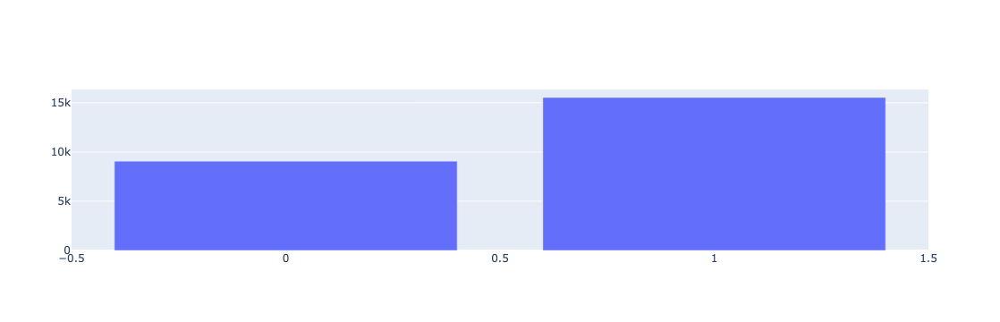

In [9]:
fig = go.Figure([go.Bar(x = [1, 0], y = df_poor.target_class.value_counts())])
fig.show()

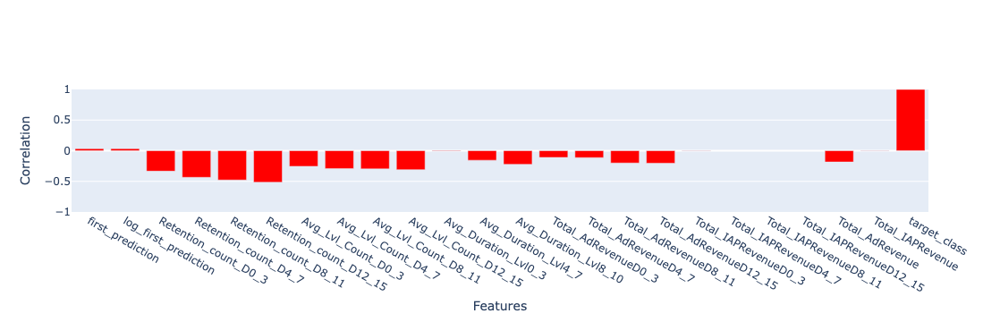

In [11]:
target_corr = df_poor[X_cols].corr()['target_class']

fig = go.Figure([go.Bar(y = target_corr, x = target_corr.index, marker_color = 'red')])

fig.update_layout(xaxis_title = "Features", yaxis_title = "Correlation",
    yaxis = dict(
        range=(-1, 1),
        showticklabels=True
    ))
fig.show()

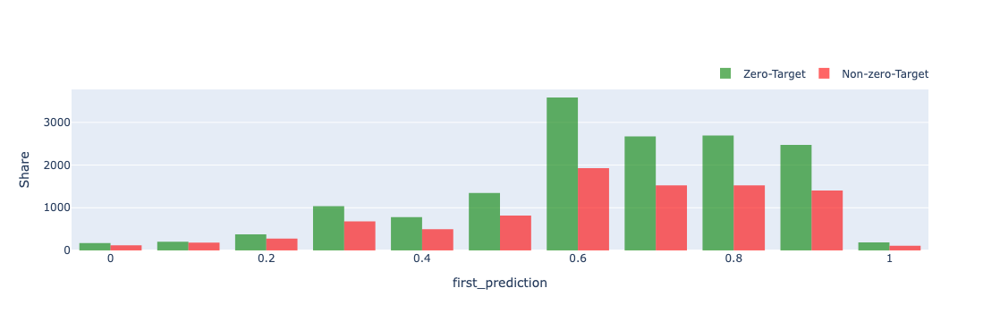

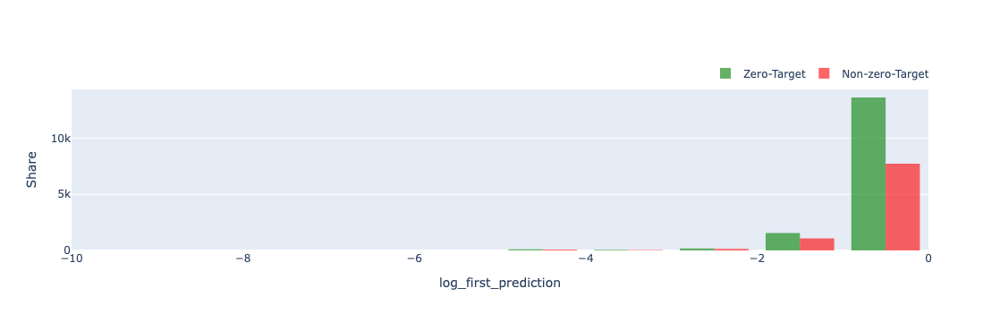

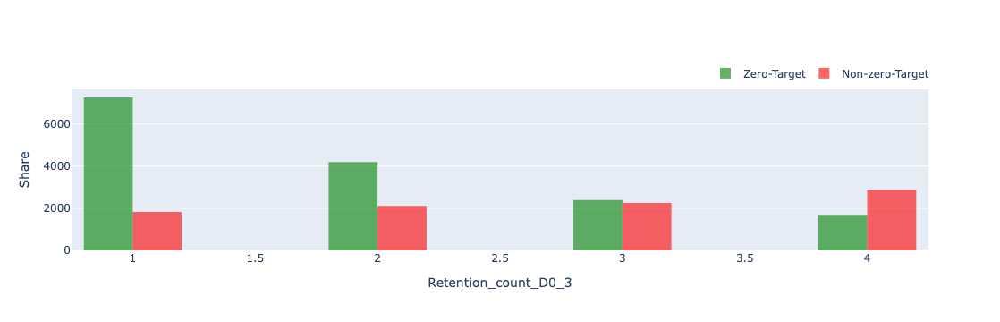

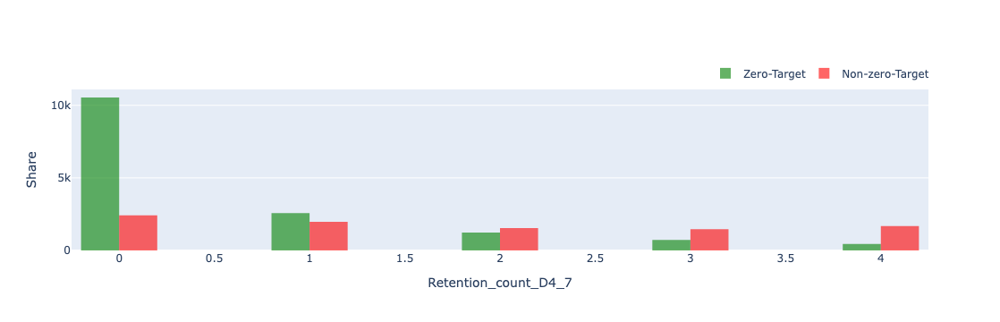

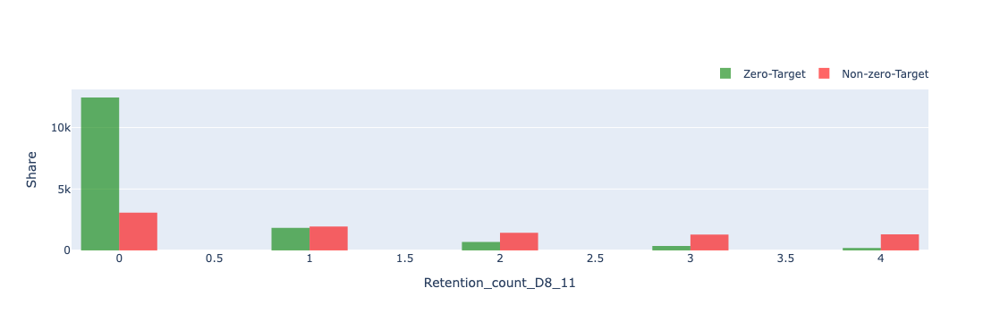

...

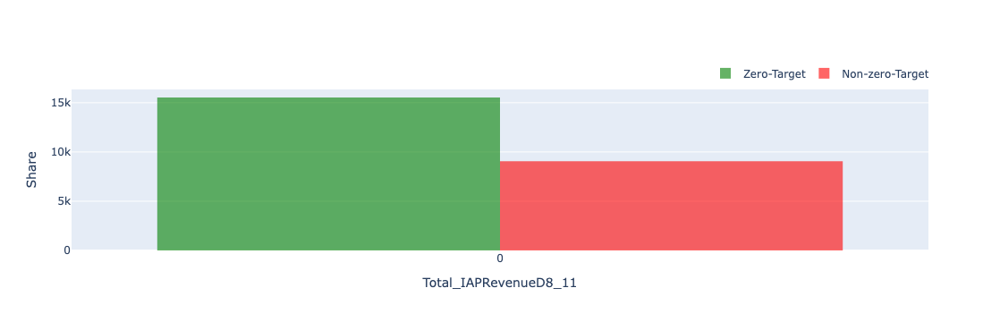

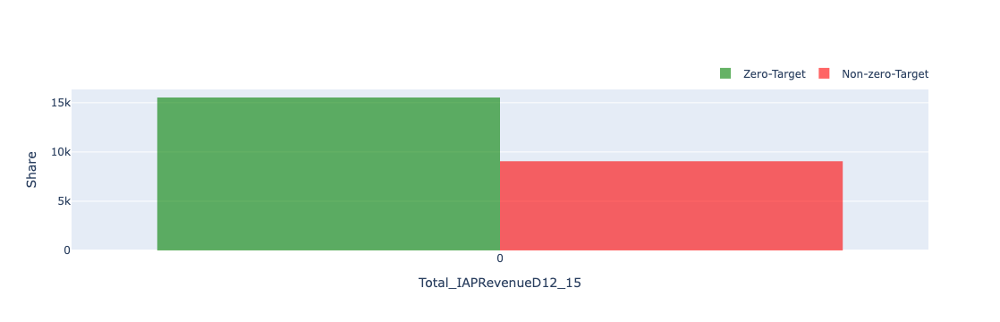

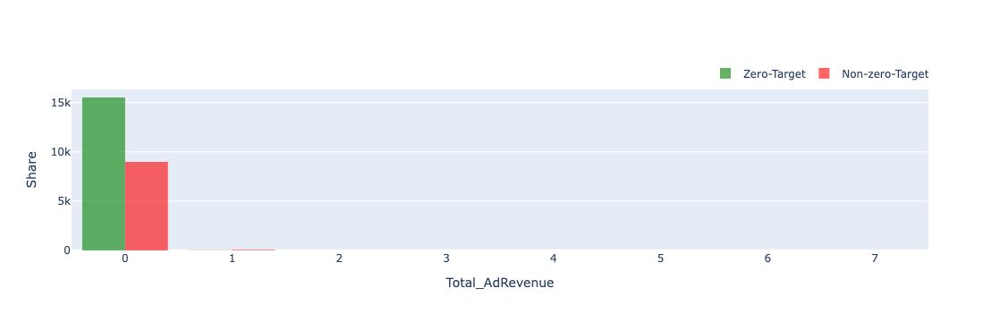

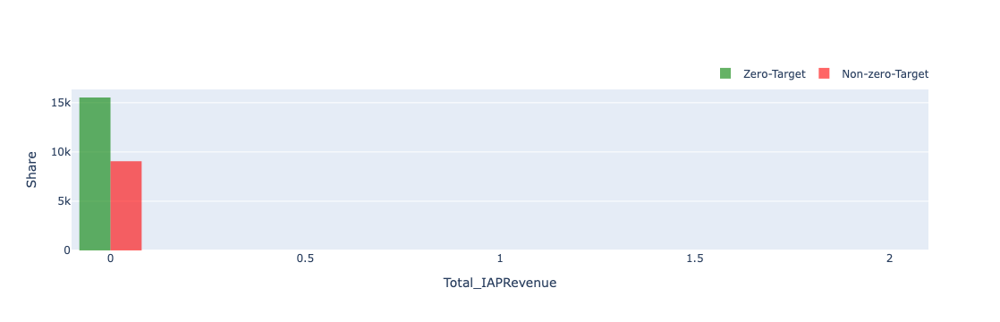

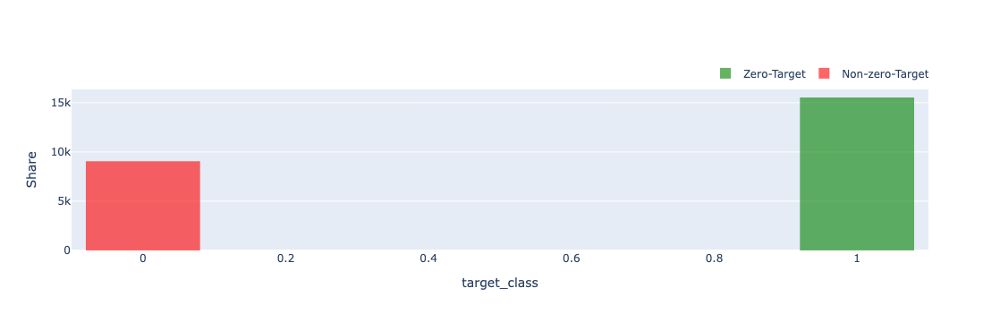

In [12]:
for feature in X_cols:

    fig = go.Figure()
    fig.add_trace(go.Histogram(x = df_poor[df_poor.target_class == 1][feature],
                 marker_color = 'green', opacity = 0.6, nbinsx = 10,  name = 'Zero-Target'))

    fig.add_trace(go.Histogram(x = df_poor[df_poor.target_class == 0][feature],
                 marker_color = 'red', opacity = 0.6,nbinsx = 10, name = 'Non-zero-Target'))

    fig.update_layout(
        legend = dict(
        orientation="h",
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1
        ),
        xaxis_title = feature,
        yaxis_title = "Share"
    )
    fig.show()

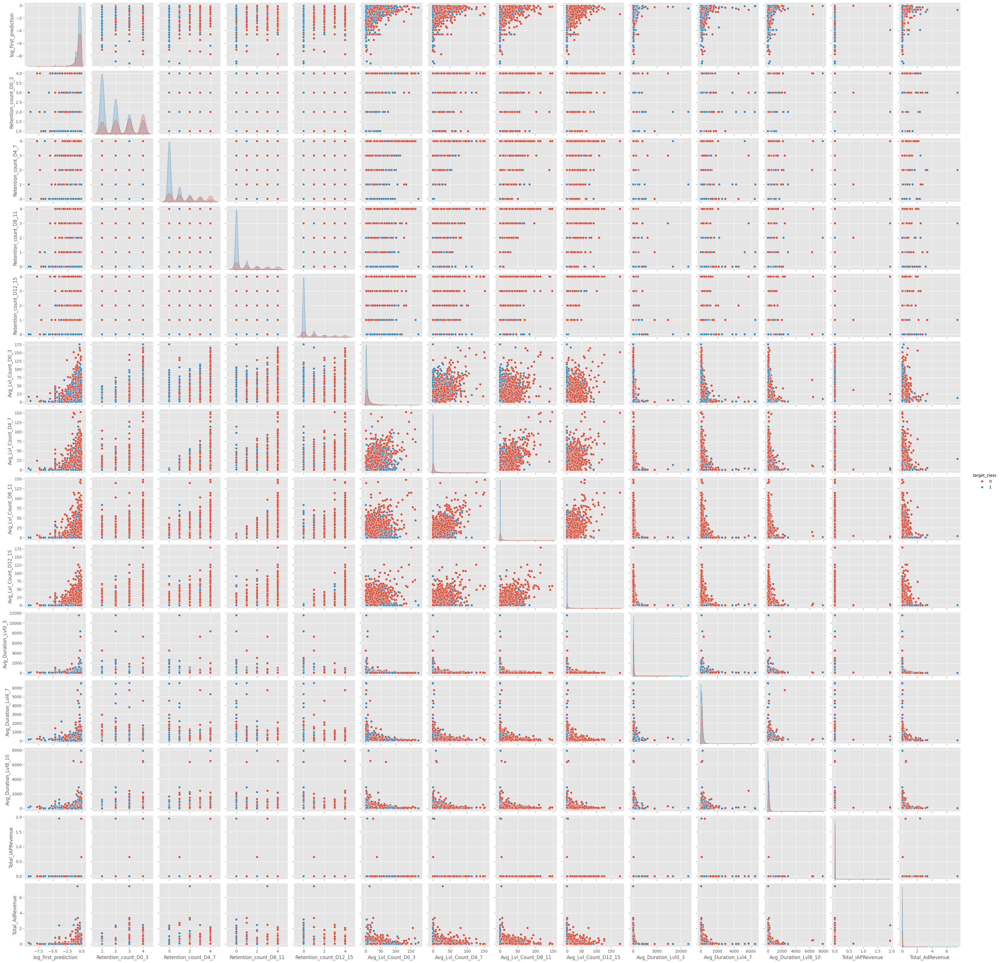

In [13]:
sns.pairplot(df_poor.loc[:,['target_class', 
                      'log_first_prediction',
                      'Retention_count_D0_3', 'Retention_count_D4_7', 'Retention_count_D8_11', 'Retention_count_D12_15',
                      'Avg_Lvl_Count_D0_3', 'Avg_Lvl_Count_D4_7', 'Avg_Lvl_Count_D8_11', 'Avg_Lvl_Count_D12_15',
                      'Avg_Duration_Lvl0_3', 'Avg_Duration_Lvl4_7', 'Avg_Duration_Lvl8_10', 
                      'Total_IAPRevenue', 'Total_AdRevenue']],
            hue = 'target_class')

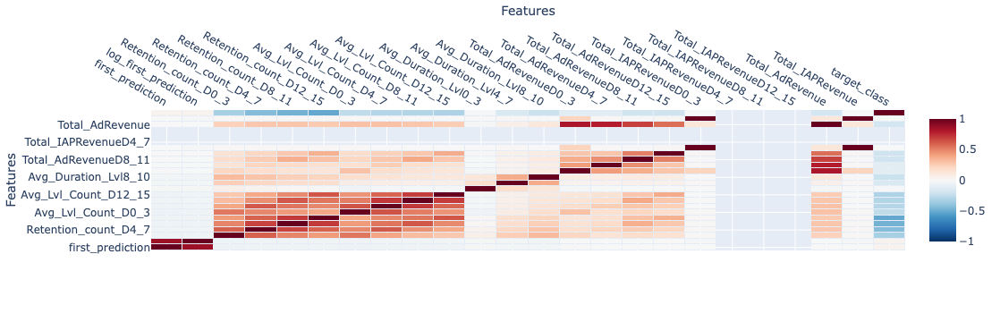

In [14]:
correlation_matrix = df_poor[X_cols].corr()

fig = go.Figure(data=go.Heatmap(
                   z = correlation_matrix,
                   x = correlation_matrix.columns,
                   y = correlation_matrix.index,
                   hoverongaps = False,
                   xgap = 1,
                   ygap = 1,
                   zmin = -1,
                   zmax = 1,
    colorscale = 'rdbu_r'
))

fig.update_xaxes(side="top")
fig.update_layout(xaxis_title = "Features", yaxis_title = "Features")
fig.show()

**Model**

In [15]:
X_cols = ['log_first_prediction',
         'Retention_count_D0_3', 'Retention_count_D4_7', 'Retention_count_D8_11', 'Retention_count_D12_15',
         'Avg_Lvl_Count_D0_3', 'Avg_Lvl_Count_D4_7', 'Avg_Lvl_Count_D8_11', 'Avg_Lvl_Count_D12_15',
         'Avg_Duration_Lvl0_3', 'Avg_Duration_Lvl4_7', 'Avg_Duration_Lvl8_10', 
         'Total_IAPRevenue', 'Total_AdRevenue']

In [16]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import f1_score, confusion_matrix, accuracy_score

In [17]:
model = RandomForestClassifier(random_state = 128)

In [18]:
scaler = MinMaxScaler()
X = pd.DataFrame(scaler.fit_transform(df_poor[X_cols]), columns=df_poor[X_cols].columns)

In [19]:
X_train, X_test, y_train, y_test = train_test_split(X, df_poor.target_class, test_size=0.2, random_state=42)

In [20]:
model.fit(X_train, y_train)

train_predictions = model.predict(X_train)
test_predictions = model.predict(X_test)

train_acc = accuracy_score(y_train, train_predictions)
test_acc = accuracy_score(y_test, test_predictions)

f1_train = f1_score(y_train, train_predictions)
f1_test = f1_score(y_test, test_predictions)

cm = confusion_matrix(y_test, test_predictions)

In [21]:
print(train_acc)
print(test_acc)

print(f1_train)
print(f1_test)

0.9991362227529089
0.7752489331436699
0.9993176253361699
0.8247226624405706


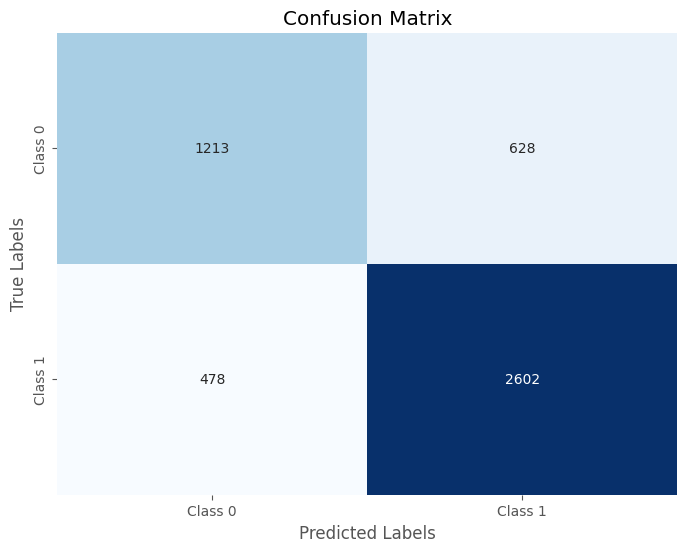

In [22]:
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False, xticklabels=['Class 0', 'Class 1'], yticklabels=['Class 0', 'Class 1'])
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

In [25]:
importances = model.feature_importances_

feature_importance_df = pd.DataFrame({'Feature': X.columns, 'Importance': importances})
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

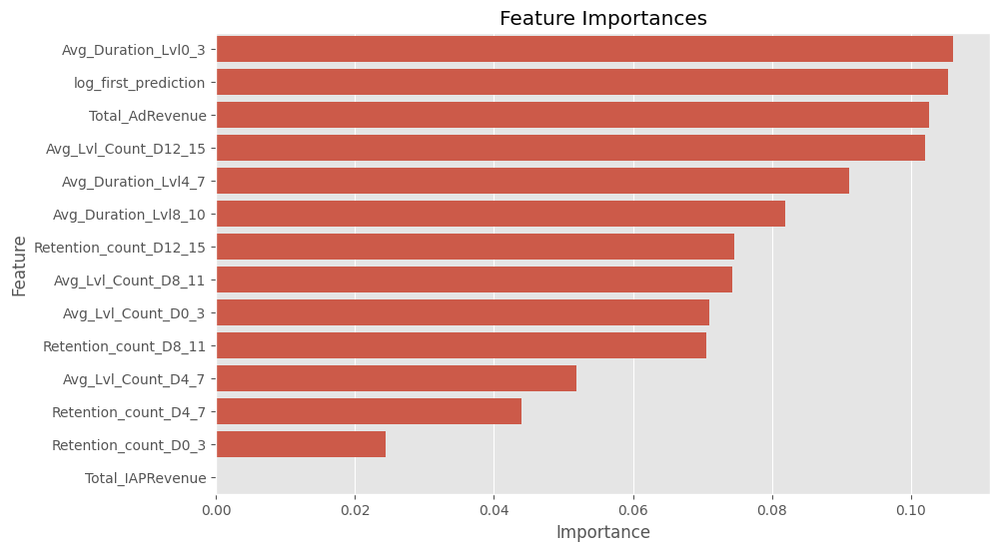

In [26]:
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feature_importance_df)
plt.title('Feature Importances')
plt.show()

In [27]:
with open('../../../models/poor_classifier.pkl', 'wb') as file:
    pickle.dump(model, file)